## 쏘카존(Socar Zone), 최적의 위치 찾기

### 4-1. 들어가며

: 렉처 노드에서는 공간 데이터의 개념, API 활용, 데이터 전처리, 다양한 라이브러리를 이용해 시각화하는 방법을 학습하였다.

이번에는 배운 것을 응용해서 실제로 쏘카에서 진행하는 업무와 같이 아래 목록의 공간 데이터를 시각화해 보는 실습을 진행할 예정이다.<br>
목록 아래에 시각화 결과 예시를 첨부함.

1. 서울시 성동구 공시지가 데이터 수집 및 시각화

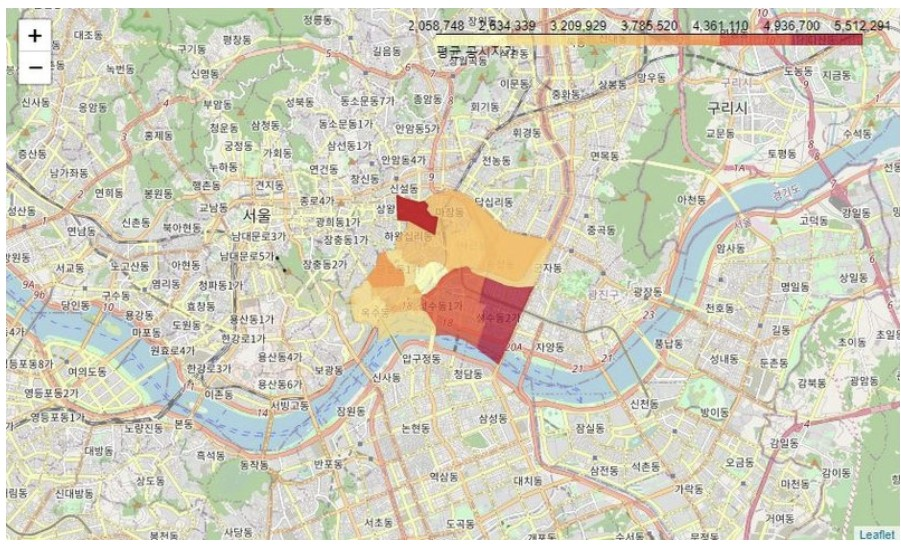

2. 서울 소재 대학교 위치 데이터 수집 및 시각화

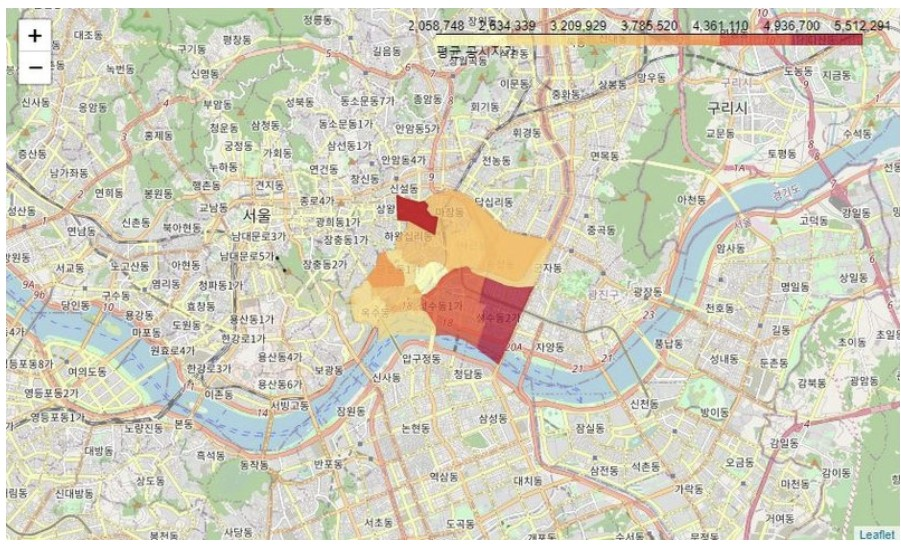

3. 전국 주차장 데이터 수집 및 시각화

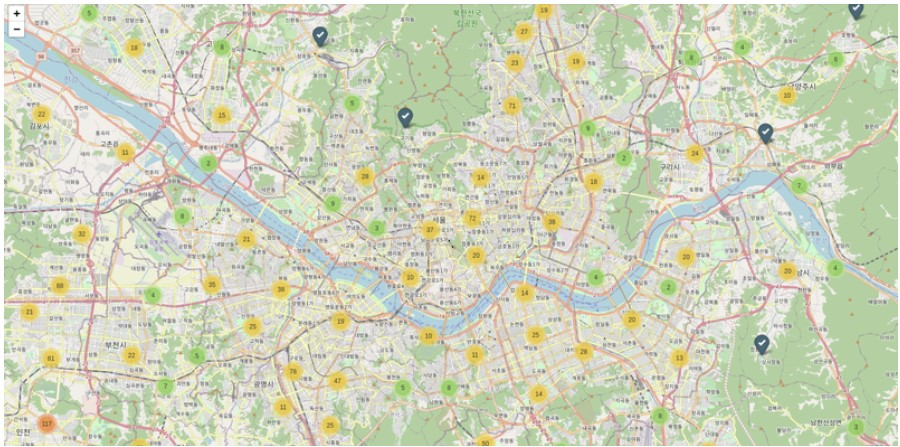

4. 서울시 구별 인구수 데이터 수집 및 시각화

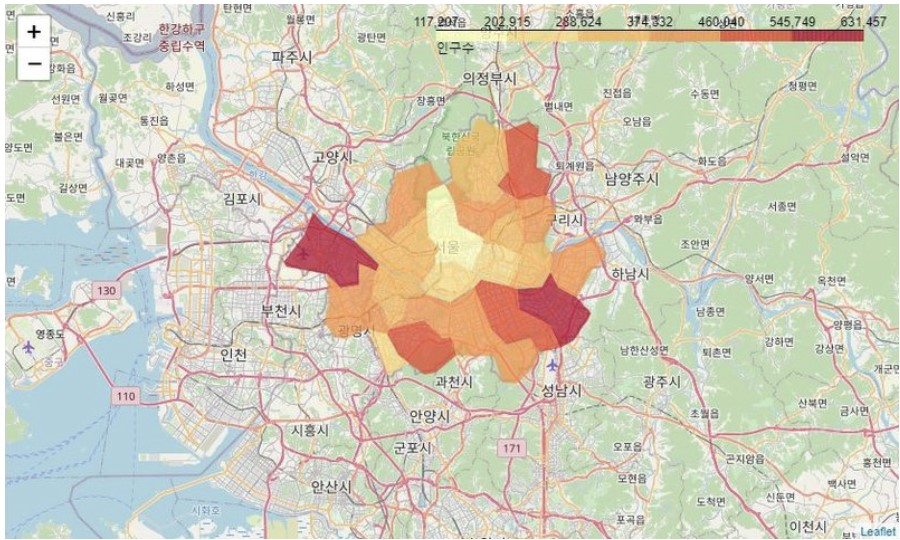

### 학습 목표

---

- 다양한 공간 데이터를 수집하고 시각화한다.
- 쏘카존 데이터를 시각화한다.
- 쏘카존 데이터를 시각화한 자료에 추가한다.

### 목차

---

1. 서울시 성동구 공시지가 데이터 수집 및 시각화
2. 서울시 대학교 데이터 수집 및 시각화
3. 전국주차장 데이터 시각화
4. 서울시 구별 인구수 데이터 수집 및 시각화
5. 프로젝트

### 준비물

---

In [1]:
!mkdir -p ~/aiffel/socar_gis/data
!ln -s ~/data/* ~/aiffel/socar_gis/data/

ln: failed to create symbolic link '/aiffel/aiffel/socar_gis/data/20210823_socar_zone.csv': File exists
ln: failed to create symbolic link '/aiffel/aiffel/socar_gis/data/administration_zone_20201001.csv': File exists
ln: failed to create symbolic link '/aiffel/aiffel/socar_gis/data/korea_seoul_sig.json': File exists
ln: failed to create symbolic link '/aiffel/aiffel/socar_gis/data/parking_lot.csv': File exists
ln: failed to create symbolic link '/aiffel/aiffel/socar_gis/data/seoul_bus_line_info.csv': File exists
ln: failed to create symbolic link '/aiffel/aiffel/socar_gis/data/seoul_store_info_202106.csv': File exists


### 4-2. 서울시 성동구 공시지가 데이터 수집 및 시각화

: 서울시 공시지가 API를 활용해서 성동구 공시지가를 시각화

**라이브러리 불러오기**

---

In [2]:
import requests
import json
import os
import math
import time
import pandas as pd
import numpy as np
import geopandas as gpd
import folium
import matplotlib.pyplot as plt

from shapely.geometry import mapping, shape, Point, Polygon, LineString
from folium import plugins
from folium.plugins import MarkerCluster, HeatMap

**데이터 수집 및 전처리**

---
Leture 노드에서 SGIS API를 사용하기 전에 access token을 반환해주는 함수를 먼저 정의하고 진행.

In [3]:
### SGIS ACCESS TOKEN을 리턴 해주는 함수
def get_access_token(consumer_key, consumer_secret) -> None:
    temp_res = requests.get(
        url="https://sgisapi.kostat.go.kr/OpenAPI3/auth/authentication.json",
        params={
            "consumer_key": consumer_key,
            "consumer_secret": consumer_secret
        }
    )

    access_token = temp_res.json()["result"]["accessToken"]
  
    return access_token

시에 속한 구이름을 리스트로 반환하는 함수 `get_si_info_list`를 정의.

In [4]:
# 시에 속한 구이름을 리스트로 리턴 받는 함수
def get_si_info_list(consumer_key, consumer_secret, cd) -> None:
    ACCESS_TOKEN=get_access_token(consumer_key, consumer_secret)
    PARAMS={
        "accessToken": ACCESS_TOKEN,
        "cd": cd # 선택) 최대 5자리, non(default): 시도정보, 2자리: 시군구, 5자리: 읍면동
        # "pg_yn": , # 선택) 경계 미포함(default): 0, 경계 포함: 1
    }

    temp_res = requests.get(
        url="https://sgisapi.kostat.go.kr/OpenAPI3/addr/stage.json",
        params=PARAMS
    )

    temp_sido_info_list = temp_res.json()["result"]
    
    return temp_sido_info_list

이제 서울시에 속하는 구들의 이름을 리스트로 가져올 예정임.<br>
서울시에 어떤 구들이 있는지 확인만 해보고 어떤 구를 선택할 지 결정.<br>
`consumer_key`, `consumer_secret` 변수에는 [SGIS API](https://sgis.kostat.go.kr/developer/html/main.html)에서 발급받은 본인 인증키 값을 입력.


In [5]:
# SGIS API 사이트의 본인의 consumer_key, consumer_secret를 입력합니다.
consumer_key = 'a20b8d305aec4181af66'       # 서비스ID
consumer_secret =  'bab2d8cd60594b2994b4' # 보안Key

temp_seoul_info_list = get_si_info_list(consumer_key, consumer_secret, 11)
seoul_gu_name_list = [gu_name["addr_name"] for gu_name in temp_seoul_info_list ]
seoul_gu_name_list

['강남구',
 '강동구',
 '강북구',
 '강서구',
 '관악구',
 '광진구',
 '구로구',
 '금천구',
 '노원구',
 '도봉구',
 '동대문구',
 '동작구',
 '마포구',
 '서대문구',
 '서초구',
 '성동구',
 '성북구',
 '송파구',
 '양천구',
 '영등포구',
 '용산구',
 '은평구',
 '종로구',
 '중구',
 '중랑구']

서울시의 많은 구 중에서 쏘카의 본사가 위치해 있는 **성동구**를 선택.<br>
다음은 서울 열린데이터 API를 활용해 서울시 성동구의 공시지가(원/m^2)를 리스트 형태로 받아온 후 DataFrame으로 생성할 예정.

아래 링크로 이동해 회원가입 및 인증키 신청 진행.
- [서울시 공시지가 정보](http://data.seoul.go.kr/dataList/OA-1180/F/1/datasetView.do)

In [7]:
# 반복문 초기값
START_INDEX = 1
END_INDEX = 1000
request_code = "INFO-000"
temp_result_list = []

while True:
    if(request_code!="INFO-000"):
        break
    elif(request_code=="INFO-000"):
        # API 조회간격 조절
        time.sleep(0.2) # 0.2초 대기후 요청

    # 요청 파라미터
    KEY = "4444504257686f6e3131387941557652" # 서울 열린데이터 광장의 본인의 인증키
    TYPE = "json"
    SERVICE = "IndividuallyPostedLandPriceService"
    START_INDEX = START_INDEX + 1000
    END_INDEX = END_INDEX + 1000
    SIGUNGU_NM = "성동구"
    YEAR = 2020

    url = f"http://openapi.seoul.go.kr:8088/{KEY}/{TYPE}/{SERVICE}/{START_INDEX}/{END_INDEX}/{SIGUNGU_NM}/ / / / /{YEAR}"

    try:
        temp_res = requests.get(
            url=url
        )

        request_code = temp_res.json()["IndividuallyPostedLandPriceService"]["RESULT"]["CODE"]
      
        temp_res_list = temp_res.json()["IndividuallyPostedLandPriceService"]["row"]
        temp_result_list = temp_res_list + temp_result_list
    
    except:
        request_code = "INFO-200"
        
print(f'총 데이터 수: {len(temp_result_list)}')

총 데이터 수: 25671


In [8]:
sungdong_gu_giga_df = pd.DataFrame(temp_result_list)
sungdong_gu_giga_df.head()

,SIGUNGU_NM,SIGUNGU_CD,BJDONG_NM,BJDONG_CD,BONBEON,BUBEON,PILGI_NM,PILGI_CD,BASE_MON,JIGA,YEAR
0,성동구,11200,용답동,12200,0047,0016,토지,1,2020-01-01,3100000,2020
1,성동구,11200,용답동,12200,0047,0015,토지,1,2020-01-01,3100000,2020
2,성동구,11200,용답동,12200,0047,0014,토지,1,2020-01-01,4334000,2020
3,성동구,11200,용답동,12200,0047,0013,토지,1,2020-01-01,1023000,2020
4,성동구,11200,용답동,12200,0047,0012,토지,1,2020-01-01,4334000,2020


In [11]:
sungdong_gu_giga_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25671 entries, 0 to 25670
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   SIGUNGU_NM  25671 non-null  object
 1   SIGUNGU_CD  25671 non-null  object
 2   BJDONG_NM   25671 non-null  object
 3   BJDONG_CD   25671 non-null  object
 4   BONBEON     25671 non-null  object
 5   BUBEON      25671 non-null  object
 6   PILGI_NM    25671 non-null  object
 7   PILGI_CD    25671 non-null  object
 8   BASE_MON    25671 non-null  object
 9   JIGA        25671 non-null  object
 10  YEAR        25671 non-null  object
dtypes: object(11)
memory usage: 2.2+ MB


공시지가의 연산을 위해 데이터 타입을 object에서 int로 변경한 후, 성동구 동별 공시지가(원/m^2)를 집계하여 평균지가 컬럼에 추가.

In [12]:
sungdong_gu_giga_df['JIGA'] = sungdong_gu_giga_df['JIGA'].astype(int)
sungdong_gu_giga_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25671 entries, 0 to 25670
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   SIGUNGU_NM  25671 non-null  object
 1   SIGUNGU_CD  25671 non-null  object
 2   BJDONG_NM   25671 non-null  object
 3   BJDONG_CD   25671 non-null  object
 4   BONBEON     25671 non-null  object
 5   BUBEON      25671 non-null  object
 6   PILGI_NM    25671 non-null  object
 7   PILGI_CD    25671 non-null  object
 8   BASE_MON    25671 non-null  object
 9   JIGA        25671 non-null  int64 
 10  YEAR        25671 non-null  object
dtypes: int64(1), object(10)
memory usage: 2.2+ MB


In [13]:
sungdong_gu_dong_giga_df = sungdong_gu_giga_df.groupby(["BJDONG_NM"])["JIGA"].mean().to_frame().reset_index()
sungdong_gu_dong_giga_df.head()

,BJDONG_NM,JIGA
0,금호동1가,2.765562e+06
1,금호동2가,3.496425e+06
2,금호동3가,3.808270e+06
3,금호동4가,3.783610e+06
4,도선동,5.473955e+06


이제 성동구 동별 평균 공시지가 데이터(`sungdong_gu_dong_giga_df`)를 얻었다. 이 데이터는 나중에 시각화를 위해 Folium에서 data로 사용될 예정이다.

다음은 성동구 정보를 SGIS에서 가져와서 GeoPandas를 이용해 GeoDataFrame을 생성할 예정이다. 생성한 `sungdong_gu_dong_gpd`는 나중에 Folium에서 geo_data로 사용할 예정이다.

In [14]:
accessToken = get_access_token(consumer_key, consumer_secret)
params={
    "accessToken": accessToken,
    "year": 2019,
    "adm_cd": 11040,    # 성동구 코드
    "low_search": 1
}

temp_res= requests.get(
    url="https://sgisapi.kostat.go.kr/OpenAPI3/boundary/hadmarea.geojson",
    params=params
)

In [15]:
sungdong_gu_dong_gpd = gpd.GeoDataFrame().from_features(temp_res.json())
sungdong_gu_dong_gpd.head()

,geometry,adm_cd,adm_nm,y,x
0,"POLYGON ((958262.940 1951830.159, 958806.169 1...",1104052,서울특별시 성동구 왕십리2동,1951605,958298
1,"POLYGON ((959182.984 1952644.101, 959214.539 1...",1104054,서울특별시 성동구 마장동,1952095,959431
2,"POLYGON ((960102.858 1951876.095, 960114.175 1...",1104055,서울특별시 성동구 사근동,1951065,959858
3,"POLYGON ((959261.179 1951611.886, 959269.655 1...",1104056,서울특별시 성동구 행당1동,1951176,959027
4,"POLYGON ((958545.562 1951320.264, 958584.077 1...",1104057,서울특별시 성동구 행당2동,1950913,958455


In [16]:
# 생성한 dataframe의 정보 확인
sungdong_gu_dong_gpd.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 17 entries, 0 to 16
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   geometry  17 non-null     geometry
 1   adm_cd    17 non-null     object  
 2   adm_nm    17 non-null     object  
 3   y         17 non-null     object  
 4   x         17 non-null     object  
dtypes: geometry(1), object(4)
memory usage: 808.0+ bytes


공시지가는 법정동 정보를 알아야 매치가 가능한데, 위에서 생성한 `sungdong_gu_dong_gpd`에는 법정동 정보가 없다. 참고로 법정동이란 법률로 지정된 명칭과 영역을 지닌 구역으로, 전통적인 지역구분, 주소, 지적(地籍) 분야에서 사용된다. 반면 행정동이란 구나 시의 하부 행정구역으로, 우리가 일상에서 사용하는  '동(洞)'을 의미한다. 예를들어 법정동 코드와 행정동 코드는 법정동과 행정동을 구분하기 위해 숫자로 만든 코드이다.

`sungdong_gu_dong_gpd` 데이터에 법정동 정보를 추가하기 위해 행정동 정보와 법정동 정보가 매핑된 `administration_zone_20201001.csv`를 DataFrame로 변환한 후, 행정구역 경계 데이터와 `merge()`를 이용하여 JOIN할 것이다.

우선 행정동 정보와 법정동 정보가 맵핑된 csv 파일을 DataFrame으로 가져와 보겠다.

In [18]:
path = os.getenv('HOME') + '/aiffel/socar_gis/data/administration_zone_20201001.csv'
address_code_mappint_df = pd.read_csv(path)
address_code_mappint_df.head()

,시도,시군구,행정구역명,행정동(행정기관명),법정동,행정구역코드,행정기관코드,행정기관 생성일,법정동코드,법정동 관할지역,행정동 영문명칭,비고,연계표 정비결과
0,서울특별시,서울특별시,서울특별시,서울특별시,서울특별시,11.0,1100000000,19880423,1100000000,NaN,Seoul,NaN,NaN
1,서울특별시,종로구,종로구,종로구,종로구,11010.0,1111000000,19880423,1111000000,NaN,Jongno-gu,NaN,NaN
2,서울특별시,종로구,청운효자동,청운효자동,청운동,1101072.0,1111051500,20081101,1111010100,NaN,Cheongunhyoja-dong,NaN,NaN
3,서울특별시,종로구,청운효자동,청운효자동,신교동,1101072.0,1111051500,20081101,1111010200,NaN,Cheongunhyoja-dong,NaN,NaN
4,서울특별시,종로구,청운효자동,청운효자동,궁정동,1101072.0,1111051500,20081101,1111010300,NaN,Cheongunhyoja-dong,NaN,NaN


행정구역코드의 데이터 타입을 float에서 object로 변경

In [19]:
address_code_mappint_df['행정구역코드'] = address_code_mappint_df["행정구역코드"].fillna(0).astype(int).astype(str)
address_code_mappint_df.head()

,시도,시군구,행정구역명,행정동(행정기관명),법정동,행정구역코드,행정기관코드,행정기관 생성일,법정동코드,법정동 관할지역,행정동 영문명칭,비고,연계표 정비결과
0,서울특별시,서울특별시,서울특별시,서울특별시,서울특별시,11,1100000000,19880423,1100000000,NaN,Seoul,NaN,NaN
1,서울특별시,종로구,종로구,종로구,종로구,11010,1111000000,19880423,1111000000,NaN,Jongno-gu,NaN,NaN
2,서울특별시,종로구,청운효자동,청운효자동,청운동,1101072,1111051500,20081101,1111010100,NaN,Cheongunhyoja-dong,NaN,NaN
3,서울특별시,종로구,청운효자동,청운효자동,신교동,1101072,1111051500,20081101,1111010200,NaN,Cheongunhyoja-dong,NaN,NaN
4,서울특별시,종로구,청운효자동,청운효자동,궁정동,1101072,1111051500,20081101,1111010300,NaN,Cheongunhyoja-dong,NaN,NaN


필요한 컬럼만 남기고, 컬럼명 변경

In [20]:
address_code_mappint_df = address_code_mappint_df[["시도", "시군구", "행정동(행정기관명)", "법정동", "행정구역코드"]]
address_code_mappint_df.head()

,시도,시군구,행정동(행정기관명),법정동,행정구역코드
0,서울특별시,서울특별시,서울특별시,서울특별시,11
1,서울특별시,종로구,종로구,종로구,11010
2,서울특별시,종로구,청운효자동,청운동,1101072
3,서울특별시,종로구,청운효자동,신교동,1101072
4,서울특별시,종로구,청운효자동,궁정동,1101072


In [22]:
address_code_mappint_df.rename(
    columns={
        "시도": "si_do",
        "시군구": "si_gun_gu",
        "행정동(행정기관명)": "hj_nm",
        "법정동": "bj_nm",
        "행정구역코드": "adm_cd"
    },
    inplace=True
)

address_code_mappint_df.head()

,si_do,si_gun_gu,hj_nm,bj_nm,adm_cd
0,서울특별시,서울특별시,서울특별시,서울특별시,11
1,서울특별시,종로구,종로구,종로구,11010
2,서울특별시,종로구,청운효자동,청운동,1101072
3,서울특별시,종로구,청운효자동,신교동,1101072
4,서울특별시,종로구,청운효자동,궁정동,1101072


성동구 행정동&법정동 DataFrame과 행정구역 경계 DataFrame을 `merge()`를 이용해 합친 후, 컬럼의 순서를 보기 좋게 변경.

In [23]:
sungdong_gu_dong_gpd = pd.merge(sungdong_gu_dong_gpd, address_code_mappint_df, how='left', on='adm_cd')
sungdong_gu_dong_gpd.head()

,geometry,adm_cd,adm_nm,y,x,si_do,si_gun_gu,hj_nm,bj_nm
0,"POLYGON ((958262.940 1951830.159, 958806.169 1...",1104052,서울특별시 성동구 왕십리2동,1951605,958298,서울특별시,성동구,왕십리제2동,하왕십리동
1,"POLYGON ((959182.984 1952644.101, 959214.539 1...",1104054,서울특별시 성동구 마장동,1952095,959431,서울특별시,성동구,마장동,마장동
2,"POLYGON ((960102.858 1951876.095, 960114.175 1...",1104055,서울특별시 성동구 사근동,1951065,959858,서울특별시,성동구,사근동,사근동
3,"POLYGON ((960102.858 1951876.095, 960114.175 1...",1104055,서울특별시 성동구 사근동,1951065,959858,서울특별시,성동구,사근동,행당동
4,"POLYGON ((959261.179 1951611.886, 959269.655 1...",1104056,서울특별시 성동구 행당1동,1951176,959027,서울특별시,성동구,행당제1동,행당동


In [24]:
sungdong_gu_dong_gpd = sungdong_gu_dong_gpd[["adm_cd", "adm_nm", "si_do", "si_gun_gu", "hj_nm", "bj_nm", "x", "y", "geometry"]]
sungdong_gu_dong_gpd.head()

,adm_cd,adm_nm,si_do,si_gun_gu,hj_nm,bj_nm,x,y,geometry
0,1104052,서울특별시 성동구 왕십리2동,서울특별시,성동구,왕십리제2동,하왕십리동,958298,1951605,"POLYGON ((958262.940 1951830.159, 958806.169 1..."
1,1104054,서울특별시 성동구 마장동,서울특별시,성동구,마장동,마장동,959431,1952095,"POLYGON ((959182.984 1952644.101, 959214.539 1..."
2,1104055,서울특별시 성동구 사근동,서울특별시,성동구,사근동,사근동,959858,1951065,"POLYGON ((960102.858 1951876.095, 960114.175 1..."
3,1104055,서울특별시 성동구 사근동,서울특별시,성동구,사근동,행당동,959858,1951065,"POLYGON ((960102.858 1951876.095, 960114.175 1..."
4,1104056,서울특별시 성동구 행당1동,서울특별시,성동구,행당제1동,행당동,959027,1951176,"POLYGON ((959261.179 1951611.886, 959269.655 1..."


이제 법정동 이름이 추가된 형태의 데이터인 `sungdong_gu_dong_gpd` 가 완성되었다. 이제 데이터에 좌표계를 정의하고 좌표계를 UTM-K -> WSG84로 변경한다.

In [25]:
# 좌표계 정의: UTM-K(epsg:5179)
sungdong_gu_dong_gpd.crs = {"init": "epsg:5179"}

# 좌표계 변환: UTM-K(덶:5197) -> WSG84(epsg:4326)
sungdong_gu_dong_gpd = sungdong_gu_dong_gpd.to_crs({"init": "epsg:4326"})
sungdong_gu_dong_gpd.head()

/opt/conda/lib/python3.9/site-packages/pyproj/crs/crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/opt/conda/lib/python3.9/site-packages/pyproj/crs/crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,adm_cd,adm_nm,si_do,si_gun_gu,hj_nm,bj_nm,x,y,geometry
0,1104052,서울특별시 성동구 왕십리2동,서울특별시,성동구,왕십리제2동,하왕십리동,958298,1951605,"POLYGON ((127.02740 37.56489, 127.03357 37.562..."
1,1104054,서울특별시 성동구 마장동,서울특별시,성동구,마장동,마장동,959431,1952095,"POLYGON ((127.03777 37.57227, 127.03813 37.572..."
2,1104055,서울특별시 성동구 사근동,서울특별시,성동구,사근동,사근동,959858,1951065,"POLYGON ((127.04823 37.56538, 127.04836 37.565..."
3,1104055,서울특별시 성동구 사근동,서울특별시,성동구,사근동,행당동,959858,1951065,"POLYGON ((127.04823 37.56538, 127.04836 37.565..."
4,1104056,서울특별시 성동구 행당1동,서울특별시,성동구,행당제1동,행당동,959027,1951176,"POLYGON ((127.03872 37.56297, 127.03881 37.562..."


GeoDataFrame의 인덱스를 동이름으로 변경.

In [26]:
sungdong_gu_dong_gpd.set_index(
    "bj_nm",
    drop=False,
    inplace=True
)

sungdong_gu_dong_gpd.head()

,adm_cd,adm_nm,si_do,si_gun_gu,hj_nm,bj_nm,x,y,geometry
bj_nm,,,,,,,,,
하왕십리동,1104052,서울특별시 성동구 왕십리2동,서울특별시,성동구,왕십리제2동,하왕십리동,958298,1951605,"POLYGON ((127.02740 37.56489, 127.03357 37.562..."
마장동,1104054,서울특별시 성동구 마장동,서울특별시,성동구,마장동,마장동,959431,1952095,"POLYGON ((127.03777 37.57227, 127.03813 37.572..."
사근동,1104055,서울특별시 성동구 사근동,서울특별시,성동구,사근동,사근동,959858,1951065,"POLYGON ((127.04823 37.56538, 127.04836 37.565..."
행당동,1104055,서울특별시 성동구 사근동,서울특별시,성동구,사근동,행당동,959858,1951065,"POLYGON ((127.04823 37.56538, 127.04836 37.565..."
행당동,1104056,서울특별시 성동구 행당1동,서울특별시,성동구,행당제1동,행당동,959027,1951176,"POLYGON ((127.03872 37.56297, 127.03881 37.562..."


In [28]:
sungdong_gu_dong_gpd[sungdong_gu_dong_gpd["bj_nm"] == "금호동1가"]

,adm_cd,adm_nm,si_do,si_gun_gu,hj_nm,bj_nm,x,y,geometry
bj_nm,,,,,,,,,
금호동1가,1104059,서울특별시 성동구 금호1가동,서울특별시,성동구,금호1가동,금호동1가,958067,1950570,"POLYGON ((127.02441 37.55790, 127.02462 37.557..."


**시각화**

---
마지막으로 Folium을 이용하기 위해 기본 맵을 생성한다. 기본 맵을 생성할 때는 중심부 위도와 경도를 입력해줘야 한다. 서울시 데이터를 이용하므로 서울시 중시무 위도와 경도인 35.541, 126.986을 입력해 준다.

그 후 Folium의 `Choropleth` 메소드를 이용해 앞서 생성한 geo-data인 `sungdong_gu_dong_gpd`와 데이터 `sungdong_gu_dong_giga_df`을 합쳐 원하는 데이터인 서울시 성동구 동별 평균 공시지가를 시각화한다.

- [Folium documentation](https://python-visualization.github.io/folium/quickstart.html#Choropleth-maps)
- [\[지도 데이터 시각화\] Part4. Folium 살펴보기](https://dailyheumsi.tistory.com/m/144?category=854906)

In [29]:
# 서울시 중심부 위도, 경도
center = [35.541, 126.986]

# map이 서울 중심부에 위치하고, zoom 레벨은 10으로 시작한다.
map = folium.Map(
    location=center,
    zoom_start=10,
)

In [30]:
folium.Choropleth(
    geo_data=sungdong_gu_dong_gpd,
    name="서울시 성동구 동별 평균 공시지가",
    data=sungdong_gu_dong_giga_df,
    columns=["BJDONG_NM", "JIGA"],
    key_on="feature.id",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    line_color='white', 
    line_weight=0,
    highlight=False, 
    smooth_factor=1.0,
    legend_name="평균 공시지가",
).add_to(map)

In [31]:
map

### 4-3. 서울시 대학교 데이터 수집 및 시각화

이번에는 서울 열린데이터광장에서 서울시 대학 및 전문대학 저오를 가져와서 시각화진행 예정.


**데이터 수집 및 전처리**

---
- [서울시 대학 및 전문대학 DB정보 (한국어)](http://data.seoul.go.kr/dataList/OA-12974/S/1/datasetView.do)

먼저 서울 열린데이터광장에서 가져온 서울시 대학교 데이터를 리스트 형태로 반환하는 함수인 `get_university_list`를 정의. 그 후 서울시 대학정보를 DataFrame으로 생성.

In [34]:
# 서울시 대학교 데이터를 리스트 형태로 가지고 오는 함수
def get_university_list() -> None:
    url="http://openapi.seoul.go.kr:8088/5274694f4f6d6f6e33395743465a61/json/SebcCollegeInfoKor/1/1000/"

    temp_res = requests.get(
        url=url,
        headers={
            "Content-Type": "application/json; chearset=utf-8"
            },
    )

    temp_result_list = temp_res.json()["SebcCollegeInfoKor"]["row"]

    return temp_result_list

In [35]:
temp_seoul_university_list = get_university_list()
seoul_university_df = pd.DataFrame(temp_seoul_university_list)
seoul_university_df.head()

,MAIN_KEY,YEAR,CATE1_NAME,NAME_KOR,BRANCH,STATE,TYPE,POSTCODE,ADD_KOR,ADD_KOR_ROAD,H_KOR_CITY,H_KOR_GU,H_KOR_DONG,TEL,FAX,HP
0,BE_LiST23-0034,2013,일반대학,서울시립대학교,본교,기존,공립,,서울 동대문구 서울시립대로 163 (전농동 90번지),,서울특별시,동대문구,휘경2동,02-6490-6114,02-2210-5576,http://www.uos.ac.kr
1,BE_LiST23-0035,2013,전문대학(3년제),서울여자간호대학교,본교,기존,사립,,서울 서대문구 홍제3동 서울여자간호대학,,서울특별시,서대문구,홍제2동,02-2287-1700,02-395-8018,http://www.snjc.ac.kr
2,BE_LiST23-0036,2013,일반대학,서울여자대학교,본교,기존,사립,,서울특별시 노원구 화랑로 621 서울여자대학교,,서울특별시,노원구,공릉2동,02-970-5114,02-978-7931,http://www.swu.ac.kr
3,BE_LiST23-0037,2013,전문대학(2년제),서일대학교,본교,학교명 변경,사립,,서울 중랑구 서일대학길 22(면목동 49-3) 서일대학교,,서울특별시,중랑구,면목제3.8동,02-490-7300,02-493-2576,http://www.seoil.ac.kr
4,BE_LiST23-0038,2013,일반대학,성공회대학교,본교,기존,사립,,서울 구로구 항동 성공회대학교,,서울특별시,구로구,오류2동,02-2610-4142,02-2610-4248,http://www.skhu.ac.kr


In [36]:
seoul_university_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64 entries, 0 to 63
Data columns (total 16 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   MAIN_KEY      64 non-null     object
 1   YEAR          64 non-null     object
 2   CATE1_NAME    64 non-null     object
 3   NAME_KOR      64 non-null     object
 4   BRANCH        64 non-null     object
 5   STATE         64 non-null     object
 6   TYPE          64 non-null     object
 7   POSTCODE      64 non-null     object
 8   ADD_KOR       64 non-null     object
 9   ADD_KOR_ROAD  64 non-null     object
 10  H_KOR_CITY    64 non-null     object
 11  H_KOR_GU      64 non-null     object
 12  H_KOR_DONG    64 non-null     object
 13  TEL           64 non-null     object
 14  FAX           64 non-null     object
 15  HP            64 non-null     object
dtypes: object(16)
memory usage: 8.1+ KB


DataFrame 컬럼 중 `STATE`는 현재 학교의 운영상태를 알려준다. 폐교한 학교의 정보는 필요없으니 `STATE`컬럼이 폐교인 데이터는 제외.

In [37]:
# 현재 학교 운영상태 확인
set(seoul_university_df['STATE'].tolist())

{'기존', '폐교', '학교명 변경', '학제 변경'}

In [38]:
# 운영상태가 폐교가 아닌 학교 필터링
seoul_university_df = seoul_university_df[seoul_university_df["STATE"]!="폐교"]
seoul_university_df.head()

,MAIN_KEY,YEAR,CATE1_NAME,NAME_KOR,BRANCH,STATE,TYPE,POSTCODE,ADD_KOR,ADD_KOR_ROAD,H_KOR_CITY,H_KOR_GU,H_KOR_DONG,TEL,FAX,HP
0,BE_LiST23-0034,2013,일반대학,서울시립대학교,본교,기존,공립,,서울 동대문구 서울시립대로 163 (전농동 90번지),,서울특별시,동대문구,휘경2동,02-6490-6114,02-2210-5576,http://www.uos.ac.kr
1,BE_LiST23-0035,2013,전문대학(3년제),서울여자간호대학교,본교,기존,사립,,서울 서대문구 홍제3동 서울여자간호대학,,서울특별시,서대문구,홍제2동,02-2287-1700,02-395-8018,http://www.snjc.ac.kr
2,BE_LiST23-0036,2013,일반대학,서울여자대학교,본교,기존,사립,,서울특별시 노원구 화랑로 621 서울여자대학교,,서울특별시,노원구,공릉2동,02-970-5114,02-978-7931,http://www.swu.ac.kr
3,BE_LiST23-0037,2013,전문대학(2년제),서일대학교,본교,학교명 변경,사립,,서울 중랑구 서일대학길 22(면목동 49-3) 서일대학교,,서울특별시,중랑구,면목제3.8동,02-490-7300,02-493-2576,http://www.seoil.ac.kr
4,BE_LiST23-0038,2013,일반대학,성공회대학교,본교,기존,사립,,서울 구로구 항동 성공회대학교,,서울특별시,구로구,오류2동,02-2610-4142,02-2610-4248,http://www.skhu.ac.kr


혹시 모르니 `STATE`컬럼을 확인해 폐교된 대학교의 데이터가 남아있는지 다시 한 번 확인.

In [40]:
set(seoul_university_df["STATE"].tolist())

{'기존', '학교명 변경', '학제 변경'}

생성한 DataFrame을 살펴보면 지리정보가 없다. 학교주소를 이용해 위도와 경도 데이터를 새로운 컬럼으로 추가한다.

먼저 주소를 입력하면 주소의 위도와 경도를 반환해주는 함수인 `get_address_x_y`을 정의.

In [44]:
# 주소를 입력해 주소의 위도, 경도를 가지고 오는 함수
def get_address_x_y(address) -> None:
    # SGIS access_token 가져오기
    access_token = get_access_token(consumer_key, consumer_secret)
    url="https://sgisapi.kostat.go.kr/OpenAPI3/addr/geocode.json"
    params={
        "accessToken": access_token,
        "address": address
    }

    temp_res = requests.get(
        url=url,
        params=params
    ).json()["result"]["resultdata"]

    return temp_res[0]["x"], temp_res[0]["y"]

주소를 조회해 위도와 경도 좌표값을 얻어 컬럼으로 추가.

In [45]:
for _, row in seoul_university_df.iterrows():
    try:
        x, y = get_address_x_y(row["ADD_KOR"])
        
        seoul_university_df.loc[_, "x"] = x
        seoul_university_df.loc[_, "y"] = y
    except:
        pass
seoul_university_df.head()

,MAIN_KEY,YEAR,CATE1_NAME,NAME_KOR,BRANCH,STATE,TYPE,POSTCODE,ADD_KOR,ADD_KOR_ROAD,H_KOR_CITY,H_KOR_GU,H_KOR_DONG,TEL,FAX,HP,x,y
0,BE_LiST23-0034,2013,일반대학,서울시립대학교,본교,기존,공립,,서울 동대문구 서울시립대로 163 (전농동 90번지),,서울특별시,동대문구,휘경2동,02-6490-6114,02-2210-5576,http://www.uos.ac.kr,960966.829074978,1953922.34300296
1,BE_LiST23-0035,2013,전문대학(3년제),서울여자간호대학교,본교,기존,사립,,서울 서대문구 홍제3동 서울여자간호대학,,서울특별시,서대문구,홍제2동,02-2287-1700,02-395-8018,http://www.snjc.ac.kr,NaN,NaN
2,BE_LiST23-0036,2013,일반대학,서울여자대학교,본교,기존,사립,,서울특별시 노원구 화랑로 621 서울여자대학교,,서울특별시,노원구,공릉2동,02-970-5114,02-978-7931,http://www.swu.ac.kr,964088.33042111,1958616.77872277
3,BE_LiST23-0037,2013,전문대학(2년제),서일대학교,본교,학교명 변경,사립,,서울 중랑구 서일대학길 22(면목동 49-3) 서일대학교,,서울특별시,중랑구,면목제3.8동,02-490-7300,02-493-2576,http://www.seoil.ac.kr,NaN,NaN
4,BE_LiST23-0038,2013,일반대학,성공회대학교,본교,기존,사립,,서울 구로구 항동 성공회대학교,,서울특별시,구로구,오류2동,02-2610-4142,02-2610-4248,http://www.skhu.ac.kr,NaN,NaN


현재 좌표계가 UTM-K이므로 WSG84좌표계로 변환.

In [46]:
# SGIS 좌표변환 API를 활용한 좌표변환 함수
def get_transcoord(src, dst, posX, posY) -> None:
    access_token = get_access_token(consumer_key, consumer_secret)
    url="https://sgisapi.kostat.go.kr/OpenAPI3/transformation/transcoord.json"
    params={
        "accessToken": access_token,
        "src": src, # 현재 좌표체계
        "dst": dst, # 변환할 좌표체계
        "posX": posX, # 변환할 좌표 X값
        "posY":	posY # 변환할 좌표 Y값
    }

    temp_dict = requests.get(
        url=url,
        params=params
    ).json()["result"]

    return temp_dict["posX"], temp_dict["posY"] # 변환된 좌표값 딕셔너리의 value 리턴

In [47]:
for _, row in seoul_university_df.iterrows():
    try:
        x, y = get_transcoord("EPSG:5179", "EPSG:4326", row["x"], row["y"])
    
        seoul_university_df.loc[_, "lng"] = x
        seoul_university_df.loc[_, "lat"] = y

    except:
        pass
seoul_university_df.head()

,MAIN_KEY,YEAR,CATE1_NAME,NAME_KOR,BRANCH,STATE,TYPE,POSTCODE,ADD_KOR,ADD_KOR_ROAD,H_KOR_CITY,H_KOR_GU,H_KOR_DONG,TEL,FAX,HP,x,y,lng,lat
0,BE_LiST23-0034,2013,일반대학,서울시립대학교,본교,기존,공립,,서울 동대문구 서울시립대로 163 (전농동 90번지),,서울특별시,동대문구,휘경2동,02-6490-6114,02-2210-5576,http://www.uos.ac.kr,960966.829074978,1953922.34300296,127.057905,37.583864
1,BE_LiST23-0035,2013,전문대학(3년제),서울여자간호대학교,본교,기존,사립,,서울 서대문구 홍제3동 서울여자간호대학,,서울특별시,서대문구,홍제2동,02-2287-1700,02-395-8018,http://www.snjc.ac.kr,NaN,NaN,NaN,NaN
2,BE_LiST23-0036,2013,일반대학,서울여자대학교,본교,기존,사립,,서울특별시 노원구 화랑로 621 서울여자대학교,,서울특별시,노원구,공릉2동,02-970-5114,02-978-7931,http://www.swu.ac.kr,964088.33042111,1958616.77872277,127.093028,37.626303
3,BE_LiST23-0037,2013,전문대학(2년제),서일대학교,본교,학교명 변경,사립,,서울 중랑구 서일대학길 22(면목동 49-3) 서일대학교,,서울특별시,중랑구,면목제3.8동,02-490-7300,02-493-2576,http://www.seoil.ac.kr,NaN,NaN,NaN,NaN
4,BE_LiST23-0038,2013,일반대학,성공회대학교,본교,기존,사립,,서울 구로구 항동 성공회대학교,,서울특별시,구로구,오류2동,02-2610-4142,02-2610-4248,http://www.skhu.ac.kr,NaN,NaN,NaN,NaN


**시각화**

---
마지막으로 Folium 초기 Map을 생성하고 서울시 대학 정보를 시각화한다.

In [48]:
# 초기 Map 메소드에는 초기 중심값 좌표가 들어가야 한다.

# 서울시 중심부 위도, 경도
center = [37.541, 126.986]

# map이 서울 중심부에 위치하고, zoom 레벨은 12로 시작.
map = folium.Map(
    location=center,
    zoom_start=12
)

In [51]:
# 대학 이름, 위도, 경도를 가져와 시각화
for _, row in seoul_university_df.iterrows():
    try:
        folium.Marker(
            location=[row["lat"], row["lng"]], # 좌표
            popup=row["NAME_KOR"], # 클릭시 표시될 popup 내용
            icon=folium.Icon(color="cadetblue", icon="info-sign") # 표시될 아이콘 설정
        ).add_to(map)
    except:
        pass

In [52]:
map

### 4-4. 전국주차장 데이터 시각화

이번에는 전국주차장 정보 표준데이터를 이용해 시각화 진행.

**데이터 전처리**

---
- [전국주차장정보표준데이터](https://www.data.go.kr/data/15012896/standard.do)

먼저 전국 주차장 정보 표준 데이터를 불러와 위도와 경도의 데이터 타입을 확인.

In [54]:
parking_station_info_df = pd.read_csv(os.getenv('HOME') + "/aiffel/socar_gis/data/parking_lot.csv", encoding="cp949")

parking_station_info_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14971 entries, 0 to 14970
Data columns (total 33 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   주차장관리번호      14971 non-null  object 
 1   주차장명         14971 non-null  object 
 2   주차장구분        14971 non-null  object 
 3   주차장유형        14971 non-null  object 
 4   소재지도로명주소     9129 non-null   object 
 5   소재지지번주소      14051 non-null  object 
 6   주차구획수        14971 non-null  int64  
 7   급지구분         14971 non-null  object 
 8   부제시행구분       14971 non-null  object 
 9   운영요일         14971 non-null  object 
 10  평일운영시작시각     14971 non-null  object 
 11  평일운영종료시각     14971 non-null  object 
 12  토요일운영시작시각    14971 non-null  object 
 13  토요일운영종료시각    14971 non-null  object 
 14  공휴일운영시작시각    14971 non-null  object 
 15  공휴일운영종료시각    14971 non-null  object 
 16  요금정보         14971 non-null  object 
 17  주차기본시간       14971 non-null  float64
 18  주차기본요금       14971 non-null  int64  
 19  추가단위

만약 위도, 경도 데이터 타입이 문자형인 경우 실수형 데이터 타입으로 변경해준다.

**시각화**

---
이제 Folium을 이용해서 초기 Map을 생성한다. 이제까지 했던 것과 마찬가지로 서울시의 위도와 경도 좌표값을 중심값으로 설정한다.

주차장의 경우 좁은 지역에 밀집되어 잇는 경우가 많기 때문에 그룹화해서 표현해야 한다. 이를 위해 마커들을 그룹화해주는 MarkerCluster 객체를 만든 후, Folium을 이용해 시각화를 진행한다.

In [55]:
# MarkerCluster 객체 만들기
marker_cluster = MarkerCluster().add_to(map)

# 주차장 이름, 위도, 경도를 가져와 marker 객체로 추가
for index_num in range(len(parking_station_info_df)):
    try:
        folium.Marker(
            location=[parking_station_info_df.loc[index_num, "위도"], parking_station_info_df.loc[index_num, "경도"]],
            popup=parking_station_info_df.loc[index_num, "소재지지번주소"],
            icon=folium.Icon(color="cadetblue", icon="ok")
        ).add_to(marker_cluster)
    except:
        pass

In [56]:
map

### 4-5. 서울시 구별 인구수 데이터 수집 및 시각화

서울시에 거주하는 구별 인구수 데이터를 수집한 후 시각화예정.

**데이터 수집 및 전처리**

---
먼저 서울시의 구단위 경계 데이터를 불러온다.

In [57]:
seoul_sig_geo_data_path = os.getenv('HOME') + '/aiffel/socar_gis/data/korea_seoul_sig.json'
seoul_sig_geo_data = json.load(
    open(seoul_sig_geo_data_path, encoding="utf-8")
)

SGIS API를 사용해야하기 때문에 access token을 리턴해주는 함수를 정의.

In [58]:
### SGIS ACCESS TOKEN을 리턴 해주는 함수
def get_access_token(consumer_key, consumer_secret) -> None:
    temp_res = requests.get(
        url="https://sgisapi.kostat.go.kr/OpenAPI3/auth/authentication.json",
        params={
            "consumer_key": consumer_key,
            "consumer_secret": consumer_secret
        }
    )

    access_token = temp_res.json()["result"]["accessToken"]
  
    return access_token

서울시에 거주하는 인구에 대한 데이터가 필요하기 때문에 서울시 구단위 인구주택총조사 정보를 가져오는 함수인 `get_population_json`을 정의.

In [59]:
### 서울시 구단위 인구주택총조사 정보 
# 응답정보 컬럼 설명 링크: https://sgis.kostat.go.kr/developer/html/openApi/api/data.html#4
def get_population_json(access_token, si_code) -> None:
    url="https://sgisapi.kostat.go.kr/OpenAPI3/stats/population.json"
    params={
        "accessToken": access_token,
        "year": 2019, # 데이터 기준연도 범위: 2000 ~ 2019 / 2019가 가장 최근 데이터
        "adm_cd": si_code, # 행정구역코드
        "low_search": 1 # 행정구역코드에 해당하는 정보만 요청: 0, 1단계 하위 행정구역 정보 요청: 1, 2단계 하위 행정구역 정보 요청: 2
    }

    temp_population_json = requests.get(
        url=url,
        params=params
    ).json()["result"]

    return temp_population_json

이제 DataFrame을 생성하고 필요한 컬럼인 구코드(adm_cd), 구이름(adm_nm), 인구수(tot_ppltn)만 남긴다. 마지막으로 알아보기 쉽게 하기 위해 컬럼 이름을 아래와 같이 변경한다.

- adm_cd -> gu_cd
- adm_nm -> gu_nm

In [63]:
# SGIS access_token 가져오기
access_token = get_access_token(consumer_key, consumer_secret)

# 서울시 구단위 행정구역 인구수 정보 데이터 프레임으로 읽어오기
seoul_gu_pop_df = pd.DataFrame(get_population_json(access_token, 11)) # 서울 시코드:11

# 서울시 구코드(adm_cd), 구이름(adm_nm), 인구수(tot_ppltn) 컬럼만 남기기
seoul_gu_pop_df = seoul_gu_pop_df[["adm_cd", "adm_nm", "tot_ppltn"]]

# 컬럼명 변경
seoul_gu_pop_df.rename(
    columns={
        "adm_cd": "gu_cd",
        "adm_nm": "gu_nm"
    },
    inplace=True
)

seoul_gu_pop_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25 entries, 0 to 24
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   gu_cd      25 non-null     object
 1   gu_nm      25 non-null     object
 2   tot_ppltn  25 non-null     object
dtypes: object(3)
memory usage: 728.0+ bytes


인구수(tot_ppltn) 컬럼은 데이터 타입을 int로 변경.

In [64]:
seoul_gu_pop_df["tot_ppltn"] = seoul_gu_pop_df["tot_ppltn"].astype(int)
seoul_gu_pop_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25 entries, 0 to 24
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   gu_cd      25 non-null     object
 1   gu_nm      25 non-null     object
 2   tot_ppltn  25 non-null     int64 
dtypes: int64(1), object(2)
memory usage: 728.0+ bytes


**시각화**

---
이제 Folium의 초기 Map을 생성하고 서울시 구단위 인구수를 시각화

In [65]:
# 서울시 중심부 위도, 경도
center = [37.541, 126.986]

# map이 서울 중시무에 위치하고, zoom 레벨은 10으로 시작.
map = folium.Map(
    location=center,
    zoom_start=10,
)

In [66]:
folium.Choropleth(
    geo_data=seoul_sig_geo_data,
    name="서울시 구단위 인구수",
    data=seoul_gu_pop_df,
    columns=["gu_nm", "tot_ppltn"],
    key_on="feature.id",
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    line_color='white', 
    line_weight=0,
    highlight=False, 
    smooth_factor=1.0,
    legend_name="인구수",
).add_to(map)

In [67]:
map